<a href="https://colab.research.google.com/github/Christian-Divinefavour/smart-water-analytics-explore_ai_team4/blob/Christian/Smart_Water_Analytics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# SMART WATER ANALYTICS - TEAM 4 INTERNS - EXPLORE AI

##### A PROJECT ON WATER AVAILABILITY MANAGEMENT

### Team Members

#### Viwe Mqaqa                             | South Africa | viwe@explore-datascience.net | Supervisor

##### Oreoluwa Onyekachi Olaiya  | Nigeria | olaiyaoreoluwa3@gmail.com
##### Christian Divinefavour           | Nigeria | contact.christiandivinefavour@gmail.com
##### Gabriel Asiegbu                      | Nigeria | gwap2@live.com
##### Titus Olang'                             | Kenya  | tityewanjohi@gmail.com
##### Michael Kanu                          | Nigeria | michaelkanu01@yahoo.com
##### Michael Omosebi                    | Nigeria | omosebimichael@live.com      

## Project Overview

The Acea Group is one of the leading Italian multiutility operators. Listed on the Italian Stock Exchange since 1999, the company manages and develops water and electricity networks and environmental services. Acea is the foremost Italian operator in the water services sector supplying 9 million inhabitants in Lazio, Tuscany, Umbria, Molise, Campania.

This project focuses on the water sector to help Acea Group preserve precious waterbodies. As it is easy to imagine, a water supply company struggles with the need to forecast the water level in a waterbody (water spring, lake, river, or aquifer) to handle daily consumption. During fall and winter waterbodies are refilled, but during spring and summer they start to drain. To help preserve the health of these waterbodies it is important to predict the most efficient water availability, in terms of level and water flow for each day of the year.


#### Kaggle Link: https://www.kaggle.com/competitions/acea-water-prediction
#### GitHub Repo: https://github.com/Christian-Divinefavour/smart-water-analytics-explore_ai_team4


## Data Overview

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
aquifers = pd.read_csv('Aquifer_Auser.csv')
#rivers = pd.read_csv('River_Arno.csv')
#lakes = pd.read_csv('Lake_Bilancino.csv')
#spring = pd.read_csv('Water_Spring_Amiata.csv')

desc = pd.read_excel('datasets_description.xlsx')
#desc = desc[((desc.Database == 'Aquifer_Auser') & (desc.Database == 'River_Arno') & (desc.Database == 'Lake_Bilancino') & (desc.Database == 'Water_Spring_Amiata'))]
pd.set_option('display.max_rows', desc.shape[0]+1)
pd.options.display.max_colwidth = 500

desc

,Database,Description,Output
0,Aquifer_Auser,"Information about the Auser aquifer. This water body consists of two subsystems, that we call NORH and SOUTH, where the former partly influences the behaviour of the latter.\nThe levels of the NORTH sector are represented by the values of the SAL, PAG, CoS and DIEC wells, while the levels of the SOUTH sector by the LT2 well.","Depth_to_Groundwater_SAL, Depth_to_Groundwater_COS, Depth_to_Groundwater_LT2"
1,Water_Spring_Amiata,"Information about the Amiata aquifer. This aquifer is accessed through the Ermicciolo, Arbure, Bugnano and Galleria Alta springs. \nThe levels and volumes of the four springs are influenced by the parameters: pluviometry, sub-gradation, hydrometry, temperatures and drainage volumes.","Flow_Rate_Bugnano, Flow_Rate_Arbure,\n Flow_Rate_Ermicciolo, Flow_Rate_Galleria_Alta"
2,Aquifer_Petrignano,Information about Petrignano aquifer. \nIt is fed by three underground aquifers separated by low permeability septa; the water table can be considered groundwater and is also fed by the Chiascio river.,"Depth_to_Groundwater_P24,\n Depth_to_Groundwater_P25"
3,Aquifer_Doganella,Information about Doganella aquifer. The Doganella well field is fed by two underground aquifers: \nthe upper stratum is a water table with a thickness of about 30m while the lower one is a semi-confined artesian aquifer with a thickness of 50m.,"Depth_to_Groundwater_Pozzo_1, Depth_to_Groundwater_Pozzo_2, Depth_to_Groundwater_Pozzo_3, Depth_to_Groundwater_Pozzo_4, Depth_to_Groundwater_Pozzo_5, Depth_to_Groundwater_Pozzo_6,\nDepth_to_Groundwater_Pozzo_7, Depth_to_Groundwater_Pozzo_8, Depth_to_Groundwater_Pozzo_9"
4,Aquifer_Luco,"Information about Luco aquifer. It is an underground aquifer not fed by rivers or lakes but fed by meteoric infiltration\n and it is accessed through wells called Pozzo_1, Pozzo_3 and Pozzo_4.",Depth_to_Groundwater_Podere_Casetta
5,River_Arno,"Information about Arno river. The Arno is the second largest river in peninsular Italy and the main waterway in Tuscany and it has a relatively torrential regime, \ndue to the nature of the surrounding soils (marl and impermeable clays)",Hydrometry_Nave_di_Rosano
6,Lake_Bilancino,"Information about Bilancino Lake. It is an artificial lake in Mugello, in the province of Florence. \n It has a maximum depth of thirty-one metres and a surface area of 5 square kilometres.","Lake_Level, \nFlow_Rate"
7,Water_Spring_Madonna_di_Canneto,Information about Madonna di Canneto water spring. The Madonna di Canneto spring is situated at an altitude of 1010m above sea level in the Canneto valley. \nIt does not consist of an aquifer and its source is supplied by the water catchment area of the river Melfa,Flow_Rate
8,Water_Spring_Lupa,Information about Lupa water spring. It is located in the Arrone area and is used for drinking use.,Flow_Rate


In [ ]:
pd.set_option('display.max_rows', aquifers.shape[0]+1)
aquifers.T

,0,1,2,3,4,5,6,7,8,9,...,8144,8145,8146,8147,8148,8149,8150,8151,8152,8153
Date,05/03/1998,06/03/1998,07/03/1998,08/03/1998,09/03/1998,10/03/1998,11/03/1998,12/03/1998,13/03/1998,14/03/1998,...,21/06/2020,22/06/2020,23/06/2020,24/06/2020,25/06/2020,26/06/2020,27/06/2020,28/06/2020,29/06/2020,30/06/2020
Rainfall_Gallicano,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
Rainfall_Pontetetto,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.4,0,0,0,0,0,0,0,0,0
Rainfall_Monte_Serra,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
Rainfall_Orentano,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
Rainfall_Borgo_a_Mozzano,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
Rainfall_Piaggione,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
Rainfall_Calavorno,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
Rainfall_Croce_Arcana,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
Rainfall_Tereglio_Coreglia_Antelminelli,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0


#### Missing values

In [ ]:
print("============")
print("Aquifers: ")
print(aquifers.shape)
print("============")
print(str(aquifers.isnull().sum()))
print("============")

Aquifers: 
(8154, 27)
Date                                          0
Rainfall_Gallicano                         2859
Rainfall_Pontetetto                        2859
Rainfall_Monte_Serra                       2865
Rainfall_Orentano                          2859
Rainfall_Borgo_a_Mozzano                   2859
Rainfall_Piaggione                         3224
Rainfall_Calavorno                         2859
Rainfall_Croce_Arcana                      2859
Rainfall_Tereglio_Coreglia_Antelminelli    2859
Rainfall_Fabbriche_di_Vallico              2859
Depth_to_Groundwater_LT2                   3352
Depth_to_Groundwater_SAL                   3609
Depth_to_Groundwater_PAG                   4347
Depth_to_Groundwater_CoS                   3839
Depth_to_Groundwater_DIEC                  4884
Temperature_Orentano                          0
Temperature_Monte_Serra                       0
Temperature_Ponte_a_Moriano                   0
Temperature_Lucca_Orto_Botanico               0
Volume_POL        

### Aquifers

In [ ]:
aquifers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8154 entries, 0 to 8153
Data columns (total 27 columns):
Date                                       8154 non-null object
Rainfall_Gallicano                         5295 non-null float64
Rainfall_Pontetetto                        5295 non-null float64
Rainfall_Monte_Serra                       5289 non-null float64
Rainfall_Orentano                          5295 non-null float64
Rainfall_Borgo_a_Mozzano                   5295 non-null float64
Rainfall_Piaggione                         4930 non-null float64
Rainfall_Calavorno                         5295 non-null float64
Rainfall_Croce_Arcana                      5295 non-null float64
Rainfall_Tereglio_Coreglia_Antelminelli    5295 non-null float64
Rainfall_Fabbriche_di_Vallico              5295 non-null float64
Depth_to_Groundwater_LT2                   4802 non-null float64
Depth_to_Groundwater_SAL                   4545 non-null float64
Depth_to_Groundwater_PAG                   3807 n

In [ ]:
aquifers.Date = pd.to_datetime(aquifers.Date, format='%d/%m/%Y')
aquifers['Year']= aquifers['Date'].dt.year
aquifers['Month']=aquifers['Date'].dt.month
aquifers['Day']=aquifers['Date'].dt.day
aquifers.head()

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,...,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day
0,1998-03-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1998,3,5
1,1998-03-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1998,3,6
2,1998-03-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1998,3,7
3,1998-03-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1998,3,8
4,1998-03-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1998,3,9


### About the Auser River

![image.png](attachment:image.png)

It is recorded as the third longest river in Italy in the region of Tucsany. 

Lucca is one of the major cities in the region and this will be used as our case study. The surrounding cities of the river, including Lucca, are of plain toporgraphy. They are majorly sites for tourists attractions and have quite a number of hotels in the area. There are no major industires or factories in the region too, hence less sources for green house depletion. There are farms and farm houses located in the area too which could aid precipitation and regulate environmental temperature with more oxygen released, than carbon. Residents, farmers, and hotels will be the major utilizers of water in this region.

In [ ]:
aquifers.head()

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,...,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day
0,1998-03-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1998,3,5
1,1998-03-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1998,3,6
2,1998-03-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1998,3,7
3,1998-03-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1998,3,8
4,1998-03-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1998,3,9


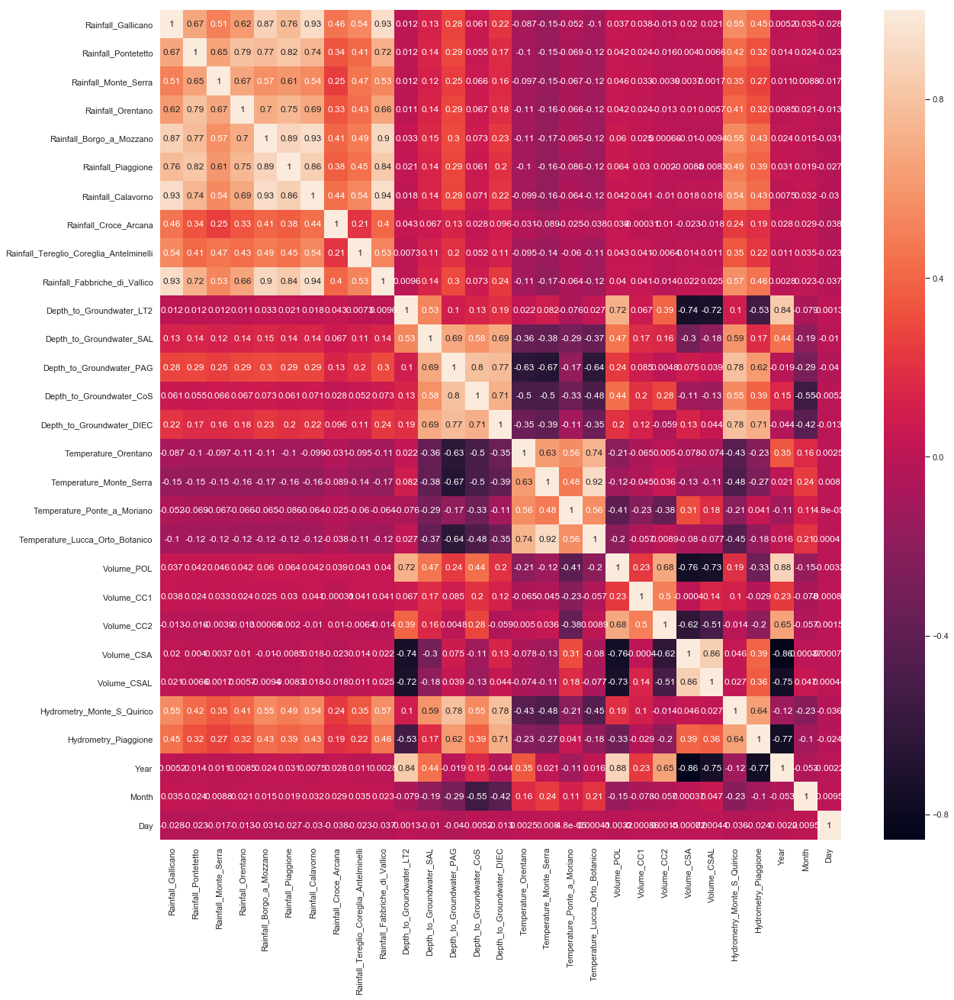

In [ ]:
sns.set(rc={'figure.figsize':(20,20)})
sns.heatmap(aquifers.corr(),annot=True)

The image above explains how closely related some features are with other. We could drop a few columns

# Missing and '0' Data Analysis

In [ ]:
pd.Series(aquifers.isnull().sum()).rename_axis('Features').to_frame('Missing Value Count')

,Missing Value Count
Features,
Date,0
Rainfall_Gallicano,2859
Rainfall_Pontetetto,2859
Rainfall_Monte_Serra,2865
Rainfall_Orentano,2859
Rainfall_Borgo_a_Mozzano,2859
Rainfall_Piaggione,3224
Rainfall_Calavorno,2859
Rainfall_Croce_Arcana,2859


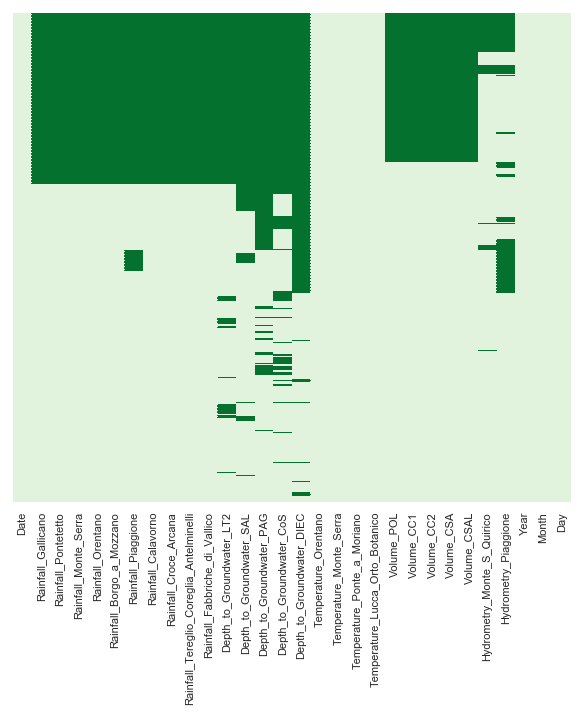

In [ ]:
sns.set(rc={'figure.figsize':(10,9)})
colormap = sns.color_palette("Greens")
sns.heatmap(aquifers.isnull(),yticklabels=False,cbar=False, cmap = colormap )

In [ ]:
df = aquifers[aquifers['Year'].isin([2009, 2010, 2011,2012,2013,2014,2015,2016,2017,2018,2019,2020])]
df.head()

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,...,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day
3955,2009-01-01,42.4,19.6,11.6,5.2,54.0,NaN,52.4,3.2,19.2,...,-10180.645160,-16472.20645,-12636.8640,0.0,0.0,0.48,NaN,2009,1,1
3956,2009-01-02,2.2,0.6,0.0,0.2,0.2,NaN,2.8,1.6,0.0,...,-10180.645160,-16472.20645,-12636.8640,0.0,0.0,0.48,NaN,2009,1,2
3957,2009-01-03,0.2,0.2,0.0,0.0,0.0,NaN,0.0,0.6,0.0,...,-10180.645160,-16472.20645,-12636.8640,0.0,0.0,0.44,NaN,2009,1,3
3958,2009-01-04,0.0,0.0,0.0,0.2,0.0,NaN,0.2,0.0,0.0,...,-9671.612903,-15648.59613,-12005.0208,0.0,0.0,0.39,NaN,2009,1,4
3959,2009-01-05,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,...,-10180.645160,-16472.20645,-12636.8640,0.0,0.0,0.35,NaN,2009,1,5


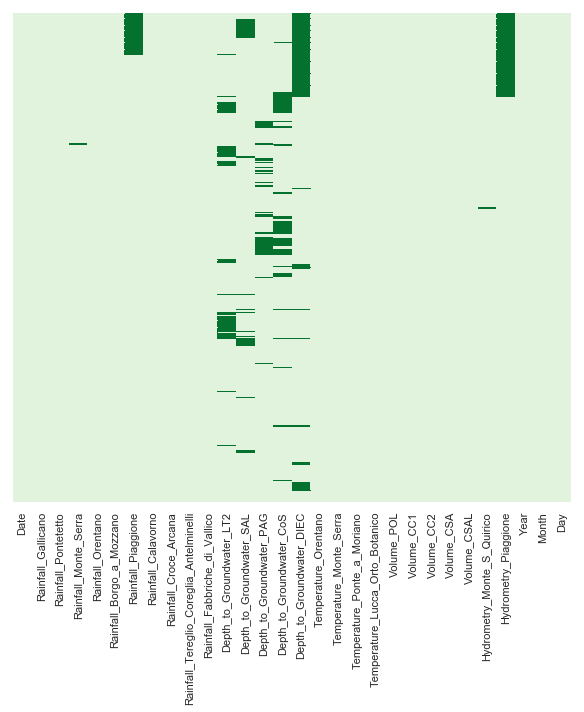

In [ ]:
sns.set(rc={'figure.figsize':(10,9)})
colormap = sns.color_palette("Greens")
sns.heatmap(df.isnull(),yticklabels=False,cbar=False, cmap = colormap )

In [ ]:
tg1 = df['Depth_to_Groundwater_SAL']
tg2 = df['Depth_to_Groundwater_CoS']
tg3 = df['Depth_to_Groundwater_LT2']


In [ ]:
tg1_level = df.groupby(["Year", "Month"]).Depth_to_Groundwater_SAL.mean().reset_index()
tg1_level.head()

,Year,Month,Depth_to_Groundwater_SAL
0,2009,1,-5.323548
1,2009,2,-4.838571
2,2009,3,-4.593333
3,2009,4,NaN
4,2009,5,NaN


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


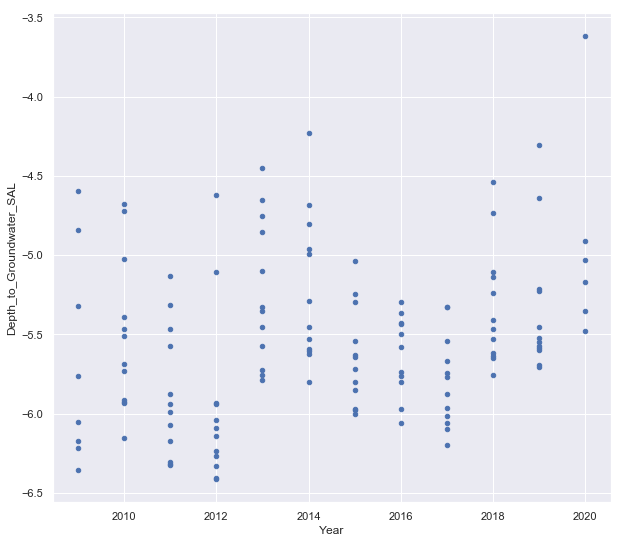

In [ ]:
tg1_level.plot.scatter(x='Year', y = 'Depth_to_Groundwater_SAL')

In [ ]:
tg1_level.max()

Year                        2020.000000
Month                         12.000000
Depth_to_Groundwater_SAL      -3.617667
dtype: float64

In [ ]:
tg2_level = df.groupby(["Year", "Month"]).Depth_to_Groundwater_CoS.mean().reset_index()
tg2_level.head()

,Year,Month,Depth_to_Groundwater_CoS
0,2009,1,-4.515484
1,2009,2,-4.520000
2,2009,3,-4.413226
3,2009,4,-4.359667
4,2009,5,-5.315484


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


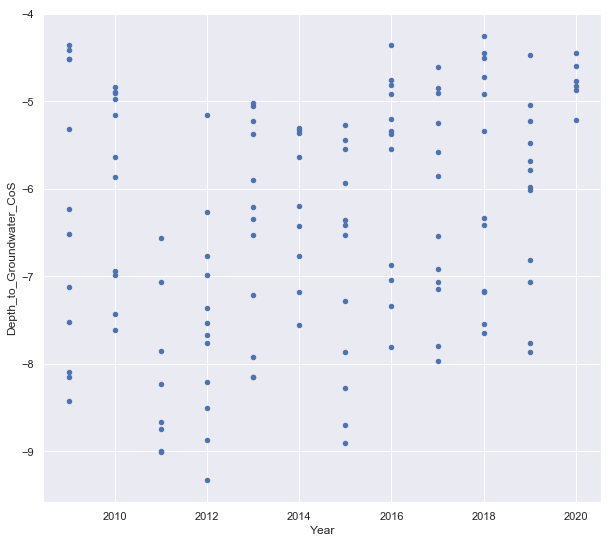

In [ ]:
tg2_level.plot.scatter(x='Year', y = 'Depth_to_Groundwater_CoS')

In [ ]:
tg2_level.max()

Year                        2020.000000
Month                         12.000000
Depth_to_Groundwater_CoS      -4.249677
dtype: float64

In [ ]:
tg3_level = df.groupby(["Year", "Month"]).Depth_to_Groundwater_LT2.mean().reset_index()
tg3_level.head()

,Year,Month,Depth_to_Groundwater_LT2
0,2009,1,-14.490968
1,2009,2,-14.389286
2,2009,3,-14.237419
3,2009,4,-14.034333
4,2009,5,-14.048710


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


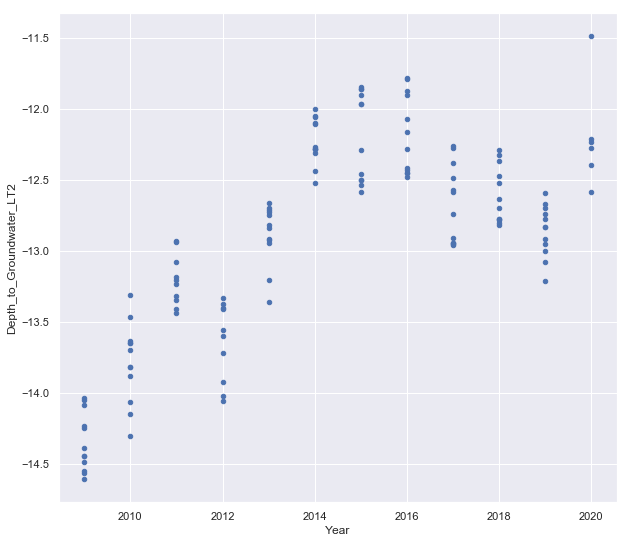

In [ ]:
tg3_level.plot.scatter(x='Year', y = 'Depth_to_Groundwater_LT2')

In [ ]:
tg3_level.max()

Year                        2020.000000
Month                         12.000000
Depth_to_Groundwater_LT2     -11.484333
dtype: float64

##### For some reason, 2020 had the least depth to groundwater. This could be as a result of the pandemic. 

In [ ]:
pd.set_option('display.max_columns', 500)
df.describe()

,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Rainfall_Fabbriche_di_Vallico,Depth_to_Groundwater_LT2,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_CoS,Depth_to_Groundwater_DIEC,Temperature_Orentano,Temperature_Monte_Serra,Temperature_Ponte_a_Moriano,Temperature_Lucca_Orto_Botanico,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day
count,4199.000000,4199.000000,4193.000000,4199.000000,4199.000000,3834.000000,4199.000000,4199.000000,4199.000000,4199.000000,3707.000000,3909.000000,3807.000000,3617.000000,3270.000000,4199.000000,4199.000000,4199.000000,4199.000000,4199.000000,4199.000000,4199.000000,4199.000000,4199.000000,4190.000000,3462.000000,4199.000000,4199.000000,4199.000000
mean,5.157371,3.651488,4.043263,3.264825,4.806906,4.160276,4.748369,2.959514,4.347607,6.128412,-12.950674,-5.533622,-1.986302,-6.354271,-3.918639,15.065468,11.539628,10.554537,15.631019,-8541.623996,-16185.292991,-11622.168039,-3171.112960,-2676.705571,0.306002,-0.797614,2014.260062,6.392713,15.724935
std,15.080130,10.284062,11.114854,8.941529,13.504281,11.344172,12.941979,9.610501,11.524565,16.942072,0.772275,0.585396,0.665692,1.390436,0.681753,7.026441,6.590020,8.855063,7.104202,1971.397188,1609.045951,1559.569020,2895.703491,2609.226802,0.231279,0.542261,3.325519,3.447469,8.798730
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-14.660000,-6.480000,-3.380000,-9.570000,-4.990000,-4.650000,-7.850000,-2.850000,-3.300000,-12420.370580,-18601.920000,-14438.304000,-7757.258065,-9497.774194,0.000000,-1.190000,2009.000000,1.000000,1.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-13.400000,-5.930000,-2.550000,-7.480000,-4.430000,9.475000,6.350000,0.000000,9.900000,-10080.645160,-16974.466950,-12726.720000,-5887.946774,-4668.677419,0.150000,-1.050000,2011.000000,3.000000,8.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-12.800000,-5.610000,-1.970000,-6.330000,-4.060000,14.850000,11.100000,10.400000,15.400000,-8769.600000,-16396.992000,-11884.320000,-4478.833333,-3428.366129,0.240000,-0.990000,2014.000000,6.000000,16.000000
75%,2.200000,1.200000,1.600000,1.000000,1.800000,1.600000,2.200000,1.400000,2.200000,2.800000,-12.430000,-5.240000,-1.510000,-5.120000,-3.550000,20.850000,16.700000,18.200000,21.650000,-6734.016000,-15785.280000,-10762.178400,0.000000,0.000000,0.390000,-0.860000,2017.000000,9.000000,23.000000
max,318.800000,146.600000,152.200000,108.800000,176.600000,140.800000,209.000000,285.000000,147.200000,197.000000,0.000000,0.000000,-0.090000,0.000000,-1.030000,30.950000,28.100000,30.650000,30.350000,-4114.670400,-7149.791935,-5569.298387,0.000000,0.000000,2.170000,3.690000,2020.000000,12.000000,31.000000


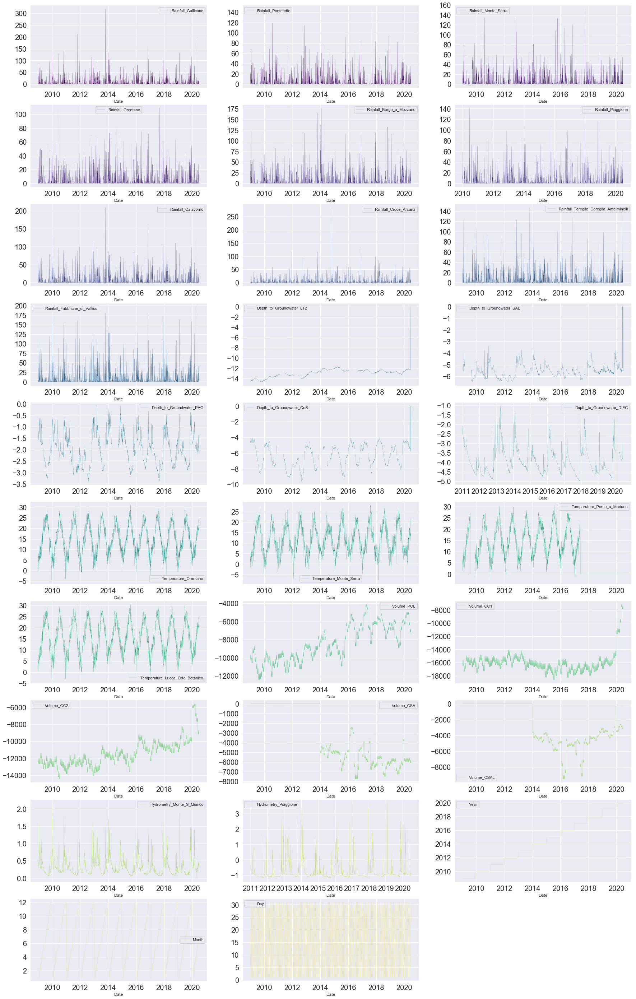

In [ ]:
df.plot(subplots=True, layout=(10, 3), x = 'Date', figsize = (30,50), sharex=False, sharey=False, 
        colormap='viridis', fontsize=20,legend=True,linewidth=0.2);
#plt.tight_layout();

#### We can see that some features like 'Temperature_Ponte_a_Moriano', 'Volume_CSAL' and 'Volume_CSA' had entries of '0' for quite a while. This could mean that they actually had value of '0' or there was no data entry for them at all (i.e. null value). 

#### I'll choose the later reason because from other sources, temperature in Tucsany about these times was not 0. We would see the correlation with other temperatures and decide on what to do with the columns.

#### Before that, I'll create a snapshot of my data frame

In [ ]:
cop = df.copy()

## Temperatures

In [ ]:
temp_df = df[['Temperature_Orentano', 'Temperature_Monte_Serra', 'Temperature_Ponte_a_Moriano', 'Temperature_Lucca_Orto_Botanico']].copy()
temp_df.head()

,Temperature_Orentano,Temperature_Monte_Serra,Temperature_Ponte_a_Moriano,Temperature_Lucca_Orto_Botanico
3955,2.25,3.90,5.25,2.70
3956,3.40,3.75,5.55,4.45
3957,4.70,-1.45,3.20,4.40
3958,-0.20,0.55,1.45,1.30
3959,-0.05,3.10,2.20,0.60


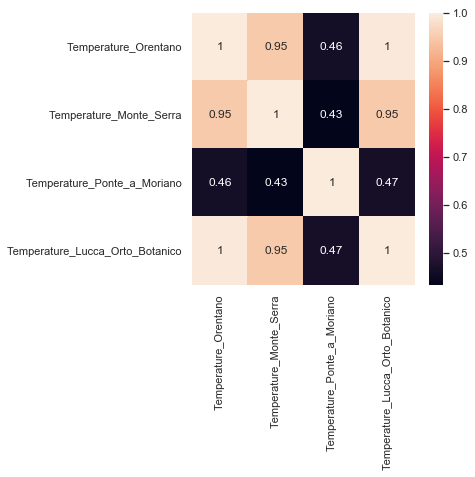

In [ ]:
sns.set(rc={'figure.figsize':(5,5)})
sns.heatmap(temp_df.corr(),annot=True)

'Temperature_Monte_Serra', 'Temperature_Lucca_Orto_Botanico' have strong positive correlation with 'Temperature_Orentano'. I'll drop the columns.

In [ ]:
temp_df = temp_df.drop(['Temperature_Monte_Serra', 'Temperature_Lucca_Orto_Botanico'], axis = 1)

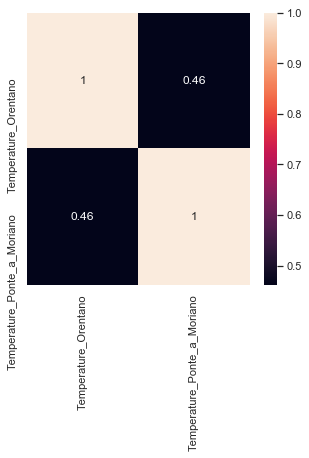

In [ ]:
sns.set(rc={'figure.figsize':(5,5)})
sns.heatmap(temp_df.corr(),annot=True)

### Implement changes on our data frame

From our earlier plots, recall that these temperature and rainfall changes are seasonal. To that, for temperature, I'll replace the 0 values with nan, group by month and day of the year, find the mean/median of each group and fill the nan values with median in this case to account for outliers

In [ ]:
df = df.drop(['Temperature_Monte_Serra', 'Temperature_Lucca_Orto_Botanico'], axis = 1)
df['Temperature_Ponte_a_Moriano'] = df['Temperature_Ponte_a_Moriano'].replace(0, np.nan)
df.head()

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Rainfall_Fabbriche_di_Vallico,Depth_to_Groundwater_LT2,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_CoS,Depth_to_Groundwater_DIEC,Temperature_Orentano,Temperature_Ponte_a_Moriano,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day
3955,2009-01-01,42.4,19.6,11.6,5.2,54.0,NaN,52.4,3.2,19.2,69.4,-14.57,-5.23,-1.41,-4.56,NaN,2.25,5.25,-10180.645160,-16472.20645,-12636.8640,0.0,0.0,0.48,NaN,2009,1,1
3956,2009-01-02,2.2,0.6,0.0,0.2,0.2,NaN,2.8,1.6,0.0,1.4,-14.54,-5.23,-1.37,-4.51,NaN,3.40,5.55,-10180.645160,-16472.20645,-12636.8640,0.0,0.0,0.48,NaN,2009,1,2
3957,2009-01-03,0.2,0.2,0.0,0.0,0.0,NaN,0.0,0.6,0.0,0.2,-14.53,-5.27,-1.43,-4.53,NaN,4.70,3.20,-10180.645160,-16472.20645,-12636.8640,0.0,0.0,0.44,NaN,2009,1,3
3958,2009-01-04,0.0,0.0,0.0,0.2,0.0,NaN,0.2,0.0,0.0,0.0,-14.53,-5.28,-1.49,-4.53,NaN,-0.20,1.45,-9671.612903,-15648.59613,-12005.0208,0.0,0.0,0.39,NaN,2009,1,4
3959,2009-01-05,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,-14.50,-5.33,-1.52,-4.54,NaN,-0.05,2.20,-10180.645160,-16472.20645,-12636.8640,0.0,0.0,0.35,NaN,2009,1,5


In [ ]:
df.tail()

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Rainfall_Fabbriche_di_Vallico,Depth_to_Groundwater_LT2,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_CoS,Depth_to_Groundwater_DIEC,Temperature_Orentano,Temperature_Ponte_a_Moriano,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day
8149,2020-06-26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-12.36,0.00,-2.04,0.00,-3.83,23.20,NaN,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0,0.20,-1.03,2020,6,26
8150,2020-06-27,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-12.36,-5.50,-2.10,-5.71,-3.84,23.60,NaN,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0,0.21,-1.03,2020,6,27
8151,2020-06-28,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-12.37,-5.49,-2.14,-5.73,-3.84,24.00,NaN,-6829.936207,-7455.505,-8724.261667,-5809.63,-3000.1,0.23,-1.03,2020,6,28
8152,2020-06-29,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-12.36,-5.50,-2.15,-5.73,-3.84,22.40,NaN,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0,0.23,-1.02,2020,6,29
8153,2020-06-30,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-12.38,-5.56,-2.17,-5.76,-3.85,23.95,NaN,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0,0.21,-1.05,2020,6,30


In [ ]:

def conditional_impute1(input_df, col, choice='mean'):
    # your code here
    output_df = input_df
    missing = output_df[output_df[col].isnull()]
    meaner = output_df.groupby(['Month','Day'])[col].mean()
    medianer = output_df.groupby(['Month','Day'])[col].median()
    def fill_missing_mean(row):
        if pd.isnull(row[col]):
            return meaner[row['Month'],row['Day']]
        else:
            return row[col]
    
    def fill_missing_meadian(row):
        if pd.isnull(row[col]):
            return medianer[row['Month'],row['Day']]
        else:
            return row[col]
    
    if choice == 'mean':
        output_df[col] = output_df.apply(fill_missing_mean, axis=1)
    elif choice == 'median':
        output_df[col] = output_df.apply(fill_missing_meadian, axis=1)
    
    return output_df

In [ ]:
conditional_impute1(df, 'Temperature_Ponte_a_Moriano', choice='median')

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Rainfall_Fabbriche_di_Vallico,Depth_to_Groundwater_LT2,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_CoS,Depth_to_Groundwater_DIEC,Temperature_Orentano,Temperature_Ponte_a_Moriano,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day
3955,2009-01-01,42.4,19.6,11.6,5.2,54.0,NaN,52.4,3.2,19.2,69.4,-14.57,-5.23,-1.41,-4.56,NaN,2.25,5.250,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.48,NaN,2009,1,1
3956,2009-01-02,2.2,0.6,0.0,0.2,0.2,NaN,2.8,1.6,0.0,1.4,-14.54,-5.23,-1.37,-4.51,NaN,3.40,5.550,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.48,NaN,2009,1,2
3957,2009-01-03,0.2,0.2,0.0,0.0,0.0,NaN,0.0,0.6,0.0,0.2,-14.53,-5.27,-1.43,-4.53,NaN,4.70,3.200,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.44,NaN,2009,1,3
3958,2009-01-04,0.0,0.0,0.0,0.2,0.0,NaN,0.2,0.0,0.0,0.0,-14.53,-5.28,-1.49,-4.53,NaN,-0.20,1.450,-9671.612903,-15648.596130,-12005.020800,0.000000,0.000000,0.39,NaN,2009,1,4
3959,2009-01-05,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,-14.50,-5.33,-1.52,-4.54,NaN,-0.05,2.200,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.35,NaN,2009,1,5
3960,2009-01-06,0.0,0.2,1.0,0.0,0.2,NaN,0.0,0.0,1.4,0.0,-14.49,-5.37,-1.60,-4.65,NaN,1.00,4.500,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.36,NaN,2009,1,6
3961,2009-01-07,18.6,6.6,27.6,22.2,11.4,NaN,8.6,0.0,28.4,16.8,-14.49,-5.39,-1.48,-4.68,NaN,5.00,5.050,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.40,NaN,2009,1,7
3962,2009-01-08,33.6,22.4,9.4,0.2,29.0,NaN,26.0,0.0,0.2,37.4,-14.55,-5.41,-1.18,-4.69,NaN,4.60,6.150,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.47,NaN,2009,1,8
3963,2009-01-09,0.0,0.0,0.0,0.0,0.2,NaN,0.2,0.0,0.2,0.0,-14.59,-5.43,-1.26,-4.69,NaN,6.80,4.250,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.43,NaN,2009,1,9
3964,2009-01-10,0.0,0.0,0.0,0.0,0.0,NaN,0.2,0.0,0.0,0.0,-14.57,-5.43,-1.35,-4.67,NaN,3.65,6.550,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.40,NaN,2009,1,10


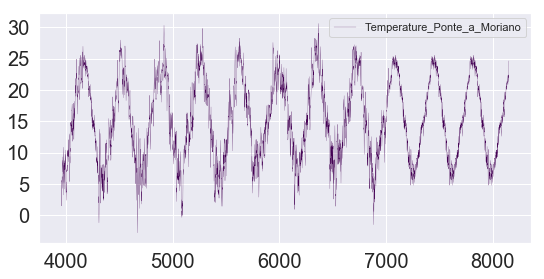

In [ ]:
df.Temperature_Ponte_a_Moriano.plot(subplots=True, layout=(10, 3), x = 'Date', figsize = (30,50), sharex=False, sharey=False, 
        colormap='viridis', fontsize=20,legend=True,linewidth=0.2);

In [ ]:
df.isnull().sum()

Date                                         0
Rainfall_Gallicano                           0
Rainfall_Pontetetto                          0
Rainfall_Monte_Serra                         6
Rainfall_Orentano                            0
Rainfall_Borgo_a_Mozzano                     0
Rainfall_Piaggione                         365
Rainfall_Calavorno                           0
Rainfall_Croce_Arcana                        0
Rainfall_Tereglio_Coreglia_Antelminelli      0
Rainfall_Fabbriche_di_Vallico                0
Depth_to_Groundwater_LT2                   492
Depth_to_Groundwater_SAL                   290
Depth_to_Groundwater_PAG                   392
Depth_to_Groundwater_CoS                   582
Depth_to_Groundwater_DIEC                  929
Temperature_Orentano                         0
Temperature_Ponte_a_Moriano                  0
Volume_POL                                   0
Volume_CC1                                   0
Volume_CC2                                   0
Volume_CSA   

## Rainfall

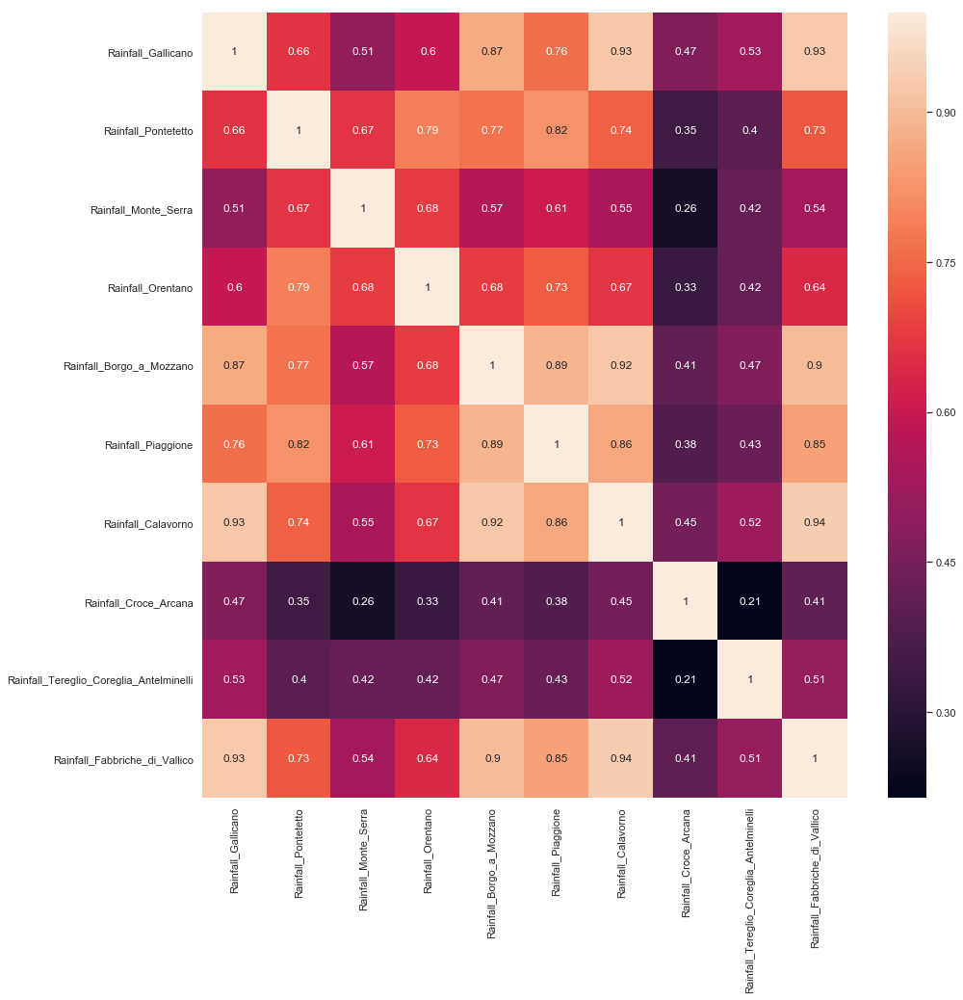

In [ ]:
rain_df = df[['Rainfall_Gallicano','Rainfall_Pontetetto','Rainfall_Monte_Serra','Rainfall_Orentano','Rainfall_Borgo_a_Mozzano',
             'Rainfall_Piaggione','Rainfall_Calavorno','Rainfall_Croce_Arcana','Rainfall_Tereglio_Coreglia_Antelminelli',
             'Rainfall_Fabbriche_di_Vallico']]
sns.set(rc={'figure.figsize':(15,15)})
sns.heatmap(rain_df.corr(),annot=True)

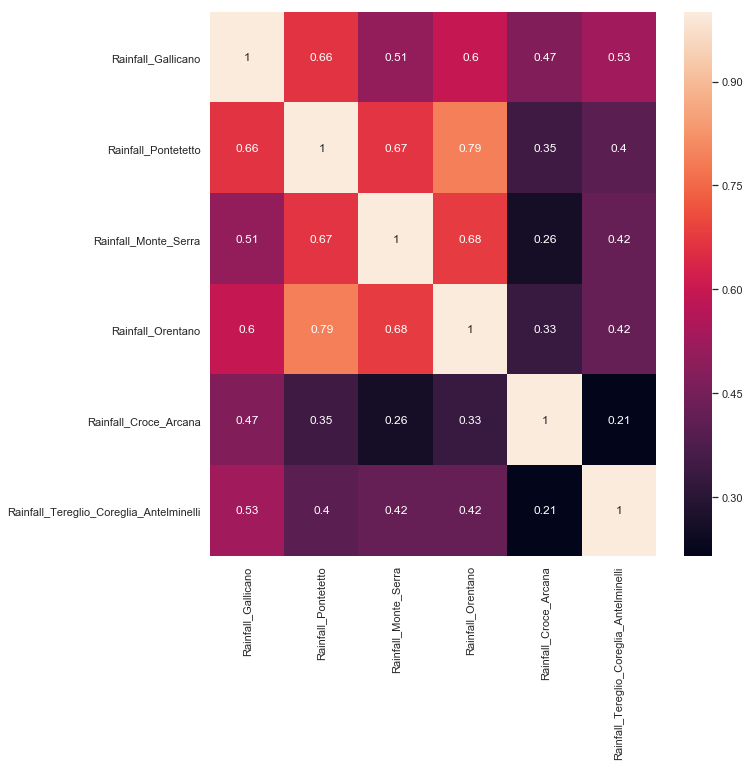

In [ ]:
rain_df = rain_df.drop(['Rainfall_Fabbriche_di_Vallico', 'Rainfall_Calavorno','Rainfall_Piaggione','Rainfall_Borgo_a_Mozzano'], axis = 1)
sns.set(rc={'figure.figsize':(10,10)})
sns.heatmap(rain_df.corr(),annot=True)

### Implementing changes on our data frame

In [ ]:
df = df.drop(['Rainfall_Fabbriche_di_Vallico', 'Rainfall_Calavorno','Rainfall_Piaggione','Rainfall_Borgo_a_Mozzano'], axis = 1)


In [ ]:
pd.Series(df.isnull().sum()).rename_axis('Features').to_frame('Missing Value Count')

,Missing Value Count
Features,
Date,0
Rainfall_Gallicano,0
Rainfall_Pontetetto,0
Rainfall_Monte_Serra,6
Rainfall_Orentano,0
Rainfall_Croce_Arcana,0
Rainfall_Tereglio_Coreglia_Antelminelli,0
Depth_to_Groundwater_LT2,492
Depth_to_Groundwater_SAL,290


In [ ]:
conditional_impute1(df, 'Rainfall_Monte_Serra', choice='median')

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Depth_to_Groundwater_LT2,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_CoS,Depth_to_Groundwater_DIEC,Temperature_Orentano,Temperature_Ponte_a_Moriano,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day
3955,2009-01-01,42.4,19.6,11.6,5.2,3.2,19.2,-14.57,-5.23,-1.41,-4.56,NaN,2.25,5.250,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.48,NaN,2009,1,1
3956,2009-01-02,2.2,0.6,0.0,0.2,1.6,0.0,-14.54,-5.23,-1.37,-4.51,NaN,3.40,5.550,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.48,NaN,2009,1,2
3957,2009-01-03,0.2,0.2,0.0,0.0,0.6,0.0,-14.53,-5.27,-1.43,-4.53,NaN,4.70,3.200,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.44,NaN,2009,1,3
3958,2009-01-04,0.0,0.0,0.0,0.2,0.0,0.0,-14.53,-5.28,-1.49,-4.53,NaN,-0.20,1.450,-9671.612903,-15648.596130,-12005.020800,0.000000,0.000000,0.39,NaN,2009,1,4
3959,2009-01-05,0.0,0.0,0.0,0.0,0.0,0.0,-14.50,-5.33,-1.52,-4.54,NaN,-0.05,2.200,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.35,NaN,2009,1,5
3960,2009-01-06,0.0,0.2,1.0,0.0,0.0,1.4,-14.49,-5.37,-1.60,-4.65,NaN,1.00,4.500,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.36,NaN,2009,1,6
3961,2009-01-07,18.6,6.6,27.6,22.2,0.0,28.4,-14.49,-5.39,-1.48,-4.68,NaN,5.00,5.050,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.40,NaN,2009,1,7
3962,2009-01-08,33.6,22.4,9.4,0.2,0.0,0.2,-14.55,-5.41,-1.18,-4.69,NaN,4.60,6.150,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.47,NaN,2009,1,8
3963,2009-01-09,0.0,0.0,0.0,0.0,0.0,0.2,-14.59,-5.43,-1.26,-4.69,NaN,6.80,4.250,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.43,NaN,2009,1,9
3964,2009-01-10,0.0,0.0,0.0,0.0,0.0,0.0,-14.57,-5.43,-1.35,-4.67,NaN,3.65,6.550,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.40,NaN,2009,1,10


## Hydrometry

In [ ]:
hyd_df = df[['Date','Hydrometry_Monte_S_Quirico' ,'Hydrometry_Piaggione']]

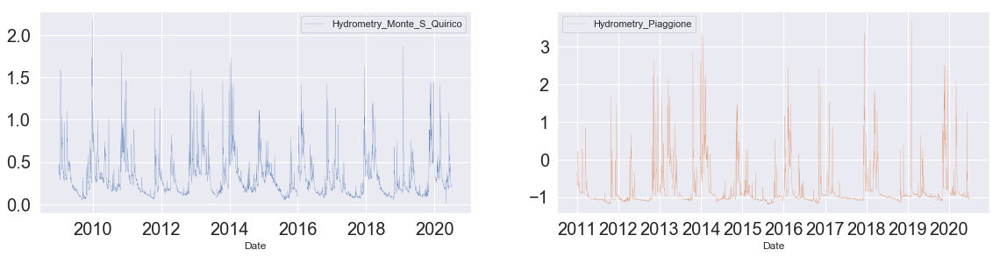

In [ ]:
hyd_df.plot.line(subplots=True, layout=(10, 3), x = 'Date', figsize = (30,50), sharex=False, sharey=False
                                                                , fontsize=20,legend=True,linewidth=0.2);

In [ ]:
conditional_impute1(df, 'Hydrometry_Piaggione', choice='mean')
conditional_impute1(df, 'Hydrometry_Monte_S_Quirico', choice='mean')

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Depth_to_Groundwater_LT2,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_CoS,Depth_to_Groundwater_DIEC,Temperature_Orentano,Temperature_Ponte_a_Moriano,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day
3955,2009-01-01,42.4,19.6,11.6,5.2,3.2,19.2,-14.57,-5.23,-1.41,-4.56,NaN,2.25,5.250,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.480000,-0.818000,2009,1,1
3956,2009-01-02,2.2,0.6,0.0,0.2,1.6,0.0,-14.54,-5.23,-1.37,-4.51,NaN,3.40,5.550,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.480000,-0.780000,2009,1,2
3957,2009-01-03,0.2,0.2,0.0,0.0,0.6,0.0,-14.53,-5.27,-1.43,-4.53,NaN,4.70,3.200,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.440000,-0.715000,2009,1,3
3958,2009-01-04,0.0,0.0,0.0,0.2,0.0,0.0,-14.53,-5.28,-1.49,-4.53,NaN,-0.20,1.450,-9671.612903,-15648.596130,-12005.020800,0.000000,0.000000,0.390000,-0.685000,2009,1,4
3959,2009-01-05,0.0,0.0,0.0,0.0,0.0,0.0,-14.50,-5.33,-1.52,-4.54,NaN,-0.05,2.200,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.350000,-0.442000,2009,1,5
3960,2009-01-06,0.0,0.2,1.0,0.0,0.0,1.4,-14.49,-5.37,-1.60,-4.65,NaN,1.00,4.500,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.360000,-0.573000,2009,1,6
3961,2009-01-07,18.6,6.6,27.6,22.2,0.0,28.4,-14.49,-5.39,-1.48,-4.68,NaN,5.00,5.050,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.400000,-0.615000,2009,1,7
3962,2009-01-08,33.6,22.4,9.4,0.2,0.0,0.2,-14.55,-5.41,-1.18,-4.69,NaN,4.60,6.150,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.470000,-0.660000,2009,1,8
3963,2009-01-09,0.0,0.0,0.0,0.0,0.0,0.2,-14.59,-5.43,-1.26,-4.69,NaN,6.80,4.250,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.430000,-0.725000,2009,1,9
3964,2009-01-10,0.0,0.0,0.0,0.0,0.0,0.0,-14.57,-5.43,-1.35,-4.67,NaN,3.65,6.550,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.400000,-0.612000,2009,1,10


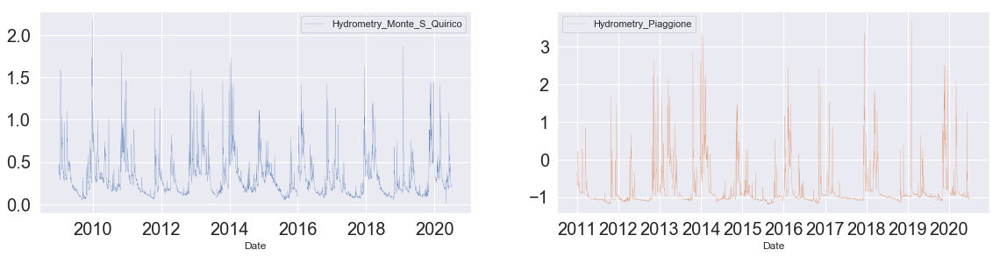

In [ ]:
hyd_df.plot.line(subplots=True, layout=(10, 3), x = 'Date', figsize = (30,50), sharex=False, sharey=False
                                                                , fontsize=20,legend=True,linewidth=0.2);

In [ ]:
pd.Series(df.isnull().sum()).rename_axis('Features').to_frame('Missing Value Count')

,Missing Value Count
Features,
Date,0
Rainfall_Gallicano,0
Rainfall_Pontetetto,0
Rainfall_Monte_Serra,0
Rainfall_Orentano,0
Rainfall_Croce_Arcana,0
Rainfall_Tereglio_Coreglia_Antelminelli,0
Depth_to_Groundwater_LT2,492
Depth_to_Groundwater_SAL,290


## Volumes

In [ ]:
vol_df = df[['Date','Year','Volume_POL' ,'Volume_CC1', 'Volume_CC2', 'Volume_CSA', 'Volume_CSAL']]
vol_df.head()

,Date,Year,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL
3955,2009-01-01,2009,-10180.645160,-16472.20645,-12636.8640,0.0,0.0
3956,2009-01-02,2009,-10180.645160,-16472.20645,-12636.8640,0.0,0.0
3957,2009-01-03,2009,-10180.645160,-16472.20645,-12636.8640,0.0,0.0
3958,2009-01-04,2009,-9671.612903,-15648.59613,-12005.0208,0.0,0.0
3959,2009-01-05,2009,-10180.645160,-16472.20645,-12636.8640,0.0,0.0


In [ ]:
vol_df.tail()

,Date,Year,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL
8149,2020-06-26,2020,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0
8150,2020-06-27,2020,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0
8151,2020-06-28,2020,-6829.936207,-7455.505,-8724.261667,-5809.63,-3000.1
8152,2020-06-29,2020,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0
8153,2020-06-30,2020,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0


#### Replacing 0 with Nan then finding patterns

In [ ]:
vol_df['Volume_POL'] = vol_df['Volume_POL'].replace(0, np.nan)
vol_df['Volume_CC1'] = vol_df['Volume_CC1'].replace(0, np.nan)
vol_df['Volume_CC2'] = vol_df['Volume_CC2'].replace(0, np.nan)
vol_df['Volume_CSA'] = vol_df['Volume_CSA'].replace(0, np.nan)
vol_df['Volume_CSAL'] = vol_df['Volume_CSAL'].replace(0, np.nan)

C:\Users\Christian-Khane\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.
C:\Users\Christian-Khane\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\Christian-Khane\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the

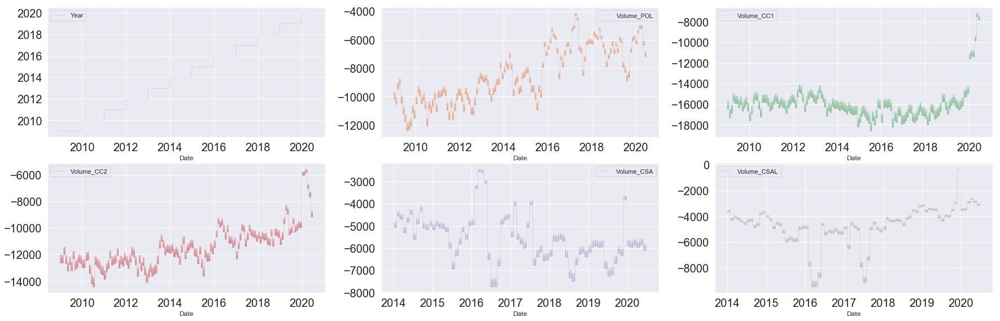

In [ ]:
vol_df.plot.line(subplots=True, layout=(10, 3), x = 'Date', figsize = (30,50), sharex=False, sharey=False
                                                                , fontsize=20,legend=True,linewidth=0.2);

In [ ]:
vol_df.head()

,Date,Year,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL
3955,2009-01-01,2009,-10180.645160,-16472.20645,-12636.8640,NaN,NaN
3956,2009-01-02,2009,-10180.645160,-16472.20645,-12636.8640,NaN,NaN
3957,2009-01-03,2009,-10180.645160,-16472.20645,-12636.8640,NaN,NaN
3958,2009-01-04,2009,-9671.612903,-15648.59613,-12005.0208,NaN,NaN
3959,2009-01-05,2009,-10180.645160,-16472.20645,-12636.8640,NaN,NaN


In [ ]:
vol_df.tail()

,Date,Year,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL
8149,2020-06-26,2020,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0
8150,2020-06-27,2020,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0
8151,2020-06-28,2020,-6829.936207,-7455.505,-8724.261667,-5809.63,-3000.1
8152,2020-06-29,2020,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0
8153,2020-06-30,2020,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0


In [ ]:
df['Volume_POL'] = df['Volume_POL'].replace(0, np.nan)
df['Volume_CC1'] = df['Volume_CC1'].replace(0, np.nan)
df['Volume_CC2'] = df['Volume_CC2'].replace(0, np.nan)
df['Volume_CSA'] = df['Volume_CSA'].replace(0, np.nan)
df['Volume_CSAL'] = df['Volume_CSAL'].replace(0, np.nan)

In [ ]:
vol_df.isnull().sum()

Date              0
Year              0
Volume_POL        0
Volume_CC1        0
Volume_CC2        0
Volume_CSA     1826
Volume_CSAL    1826
dtype: int64

#### Attempt to find missing values using ML

In [ ]:
df_csa = vol_df[['Year','Volume_POL' ,'Volume_CC1', 'Volume_CC2', 'Volume_CSA']]
df_csal = vol_df[['Year','Volume_POL' ,'Volume_CC1', 'Volume_CC2', 'Volume_CSAL']]

In [ ]:
#Test Data for Volume_CSA

tdf_csa = df_csa[df_csa.Volume_CSA.isnull()]
df_csa.dropna(inplace = True)

,Year,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA
3955,2009,-10180.645160,-16472.20645,-12636.86400,NaN
3956,2009,-10180.645160,-16472.20645,-12636.86400,NaN
3957,2009,-10180.645160,-16472.20645,-12636.86400,NaN
3958,2009,-9671.612903,-15648.59613,-12005.02080,NaN
3959,2009,-10180.645160,-16472.20645,-12636.86400,NaN
3960,2009,-10180.645160,-16472.20645,-12636.86400,NaN
3961,2009,-10180.645160,-16472.20645,-12636.86400,NaN
3962,2009,-10180.645160,-16472.20645,-12636.86400,NaN
3963,2009,-10180.645160,-16472.20645,-12636.86400,NaN
3964,2009,-10180.645160,-16472.20645,-12636.86400,NaN


In [ ]:
x_train = df_csa.drop('Volume_CSA', axis = 1)
y_train = df_csa['Volume_CSA']
x_test = tdf_csa[['Year','Volume_POL' ,'Volume_CC1', 'Volume_CC2']]

In [ ]:
import xgboost as xgb
xg = xgb.XGBRegressor()

xg.fit(x_train, y_train)
y_pred = xg.predict(x_test)
tdf_csa['Volume_CSA'] = y_pred

C:\Users\Christian-Khane\Anaconda3\lib\site-packages\sklearn\utils\validation.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  LARGE_SPARSE_SUPPORTED = LooseVersion(scipy_version) >= '0.14.0'


In [ ]:
tdf_csa.head()

,Year,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA
3955,2009,-10180.645160,-16472.20645,-12636.8640,-5131.086914
3956,2009,-10180.645160,-16472.20645,-12636.8640,-5131.086914
3957,2009,-10180.645160,-16472.20645,-12636.8640,-5131.086914
3958,2009,-9671.612903,-15648.59613,-12005.0208,-4708.067383
3959,2009,-10180.645160,-16472.20645,-12636.8640,-5131.086914


In [ ]:
tdf_csa.tail()

,Year,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA
5776,2013,-8769.60,-16421.70240,-11884.320,-5152.609375
5777,2013,-8769.60,-16421.70240,-11884.320,-5152.609375
5778,2013,-8331.12,-15600.61728,-11290.104,-5177.462891
5779,2013,-8769.60,-16421.70240,-11884.320,-5152.609375
5780,2013,-8769.60,-16421.70240,-11884.320,-5152.609375


In [ ]:
#Train and Test Data for Volume_CSAl

tdf_csal = df_csal[df_csal.Volume_CSAL.isnull()]
df_csal.dropna(inplace = True)
xx_train = df_csal.drop('Volume_CSAL', axis = 1)
yy_train = df_csal['Volume_CSAL']

C:\Users\Christian-Khane\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


In [ ]:
xg.fit(xx_train, yy_train)
xx_test = tdf_csal[['Year','Volume_POL' ,'Volume_CC1', 'Volume_CC2']]
yy_pred = xg.predict(x_test)

tdf_csal['Volume_CSAL'] = yy_pred
tdf_csal.tail()

In [ ]:
# Create a new df to hold original and predicted volumes
vol_pred = pd.concat([tdf_csa.Volume_CSA, tdf_csal.Volume_CSAL ], axis = 1)
vol_orig = pd.concat([df_csa.Volume_CSA, df_csal.Volume_CSAL ], axis = 1)

vol_new = pd.concat([vol_pred, vol_orig ])

In [ ]:
# Replacing missing volumes in original data frames

df['Volume_CSA'] = vol_new['Volume_CSA']
df['Volume_CSAL'] = vol_new['Volume_CSAL']
vol_df['Volume_CSA'] = vol_new['Volume_CSA']
vol_df['Volume_CSAL'] = vol_new['Volume_CSAL']

C:\Users\Christian-Khane\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """
C:\Users\Christian-Khane\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


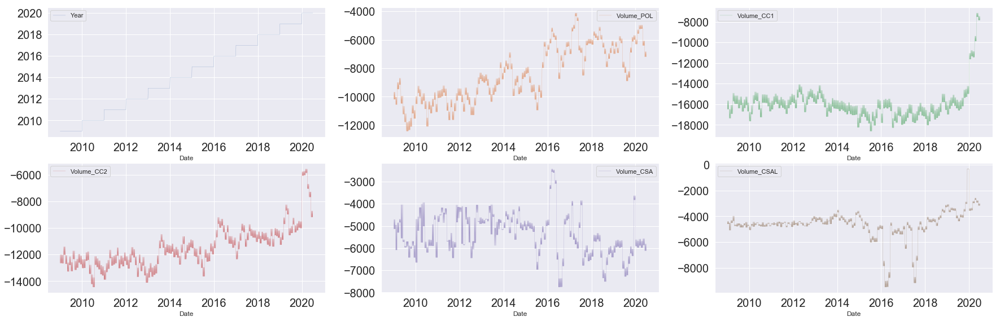

In [ ]:
vol_df.plot.line(subplots=True, layout=(10, 3), x = 'Date', figsize = (30,50), sharex=False, sharey=False
                                                                , fontsize=20,legend=True,linewidth=0.2);

## Depth to Groundwater

In [ ]:
dtg_df = df[['Date','Year','Month','Day','Depth_to_Groundwater_LT2' ,'Depth_to_Groundwater_SAL', 
             'Depth_to_Groundwater_PAG', 'Depth_to_Groundwater_CoS', 'Depth_to_Groundwater_DIEC']]
dtg_df.head()

,Date,Year,Month,Day,Depth_to_Groundwater_LT2,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_CoS,Depth_to_Groundwater_DIEC
3955,2009-01-01,2009,1,1,-14.57,-5.23,-1.41,-4.56,NaN
3956,2009-01-02,2009,1,2,-14.54,-5.23,-1.37,-4.51,NaN
3957,2009-01-03,2009,1,3,-14.53,-5.27,-1.43,-4.53,NaN
3958,2009-01-04,2009,1,4,-14.53,-5.28,-1.49,-4.53,NaN
3959,2009-01-05,2009,1,5,-14.50,-5.33,-1.52,-4.54,NaN


In [ ]:
pd.Series(dtg_df.isnull().sum()).rename_axis('Targets').to_frame('Missing Value Count')

,Missing Value Count
Targets,
Date,0
Year,0
Month,0
Day,0
Depth_to_Groundwater_LT2,492
Depth_to_Groundwater_SAL,290
Depth_to_Groundwater_PAG,392
Depth_to_Groundwater_CoS,582
Depth_to_Groundwater_DIEC,929


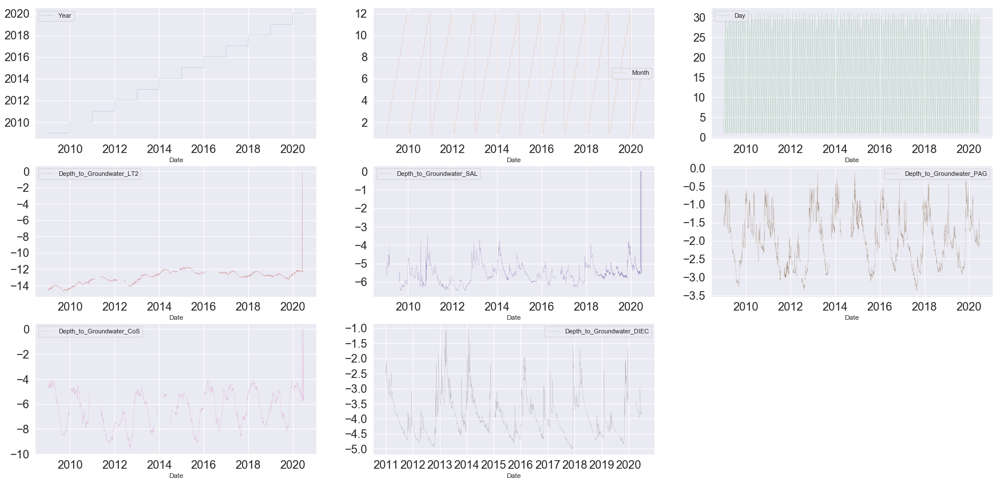

In [ ]:
dtg_df.plot.line(subplots=True, layout=(10, 3), x = 'Date', figsize = (30,50), sharex=False, sharey=False
                                                                , fontsize=20,legend=True,linewidth=0.2);

In [ ]:
conditional_impute1(df, 'Depth_to_Groundwater_PAG', choice='median')
conditional_impute1(df, 'Depth_to_Groundwater_DIEC', choice='median')

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Depth_to_Groundwater_LT2,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_CoS,Depth_to_Groundwater_DIEC,Temperature_Orentano,Temperature_Ponte_a_Moriano,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day
3955,2009-01-01,42.4,19.6,11.6,5.2,3.2,19.2,-14.57,-5.23,-1.410,-4.56,-3.785,2.25,5.250,-10180.645160,-16472.206450,-12636.864000,-5131.086914,-4589.596191,0.480000,-0.818000,2009,1,1
3956,2009-01-02,2.2,0.6,0.0,0.2,1.6,0.0,-14.54,-5.23,-1.370,-4.51,-3.710,3.40,5.550,-10180.645160,-16472.206450,-12636.864000,-5131.086914,-4589.596191,0.480000,-0.780000,2009,1,2
3957,2009-01-03,0.2,0.2,0.0,0.0,0.6,0.0,-14.53,-5.27,-1.430,-4.53,-3.550,4.70,3.200,-10180.645160,-16472.206450,-12636.864000,-5131.086914,-4589.596191,0.440000,-0.715000,2009,1,3
3958,2009-01-04,0.0,0.0,0.0,0.2,0.0,0.0,-14.53,-5.28,-1.490,-4.53,-3.420,-0.20,1.450,-9671.612903,-15648.596130,-12005.020800,-4708.067383,-4386.522461,0.390000,-0.685000,2009,1,4
3959,2009-01-05,0.0,0.0,0.0,0.0,0.0,0.0,-14.50,-5.33,-1.520,-4.54,-3.420,-0.05,2.200,-10180.645160,-16472.206450,-12636.864000,-5131.086914,-4589.596191,0.350000,-0.442000,2009,1,5
3960,2009-01-06,0.0,0.2,1.0,0.0,0.0,1.4,-14.49,-5.37,-1.600,-4.65,-3.440,1.00,4.500,-10180.645160,-16472.206450,-12636.864000,-5131.086914,-4589.596191,0.360000,-0.573000,2009,1,6
3961,2009-01-07,18.6,6.6,27.6,22.2,0.0,28.4,-14.49,-5.39,-1.480,-4.68,-3.460,5.00,5.050,-10180.645160,-16472.206450,-12636.864000,-5131.086914,-4589.596191,0.400000,-0.615000,2009,1,7
3962,2009-01-08,33.6,22.4,9.4,0.2,0.0,0.2,-14.55,-5.41,-1.180,-4.69,-3.490,4.60,6.150,-10180.645160,-16472.206450,-12636.864000,-5131.086914,-4589.596191,0.470000,-0.660000,2009,1,8
3963,2009-01-09,0.0,0.0,0.0,0.0,0.0,0.2,-14.59,-5.43,-1.260,-4.69,-3.550,6.80,4.250,-10180.645160,-16472.206450,-12636.864000,-5131.086914,-4589.596191,0.430000,-0.725000,2009,1,9
3964,2009-01-10,0.0,0.0,0.0,0.0,0.0,0.0,-14.57,-5.43,-1.350,-4.67,-3.600,3.65,6.550,-10180.645160,-16472.206450,-12636.864000,-5131.086914,-4589.596191,0.400000,-0.612000,2009,1,10


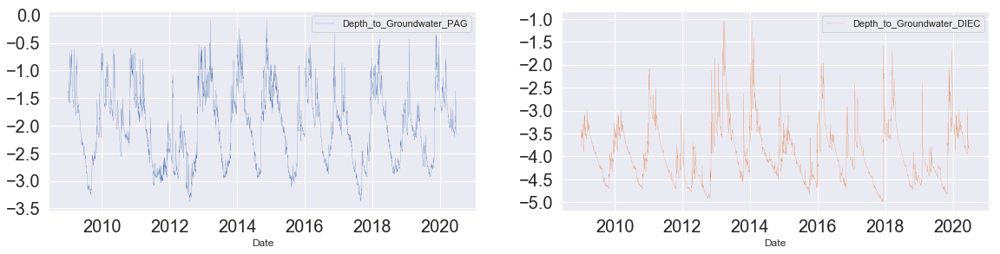

In [ ]:
ndtg_df = df[['Date','Depth_to_Groundwater_PAG', 'Depth_to_Groundwater_DIEC']]
ndtg_df.plot.line(subplots=True, layout=(10, 3), x = 'Date', figsize = (30,50), sharex=False, sharey=False
                                                                , fontsize=20,legend=True,linewidth=0.2);

## EDA Summary

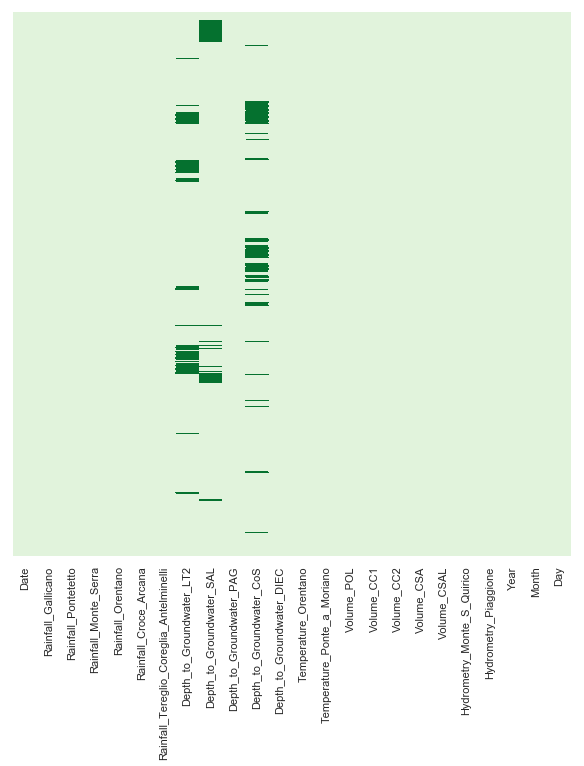

In [ ]:
sns.set(rc={'figure.figsize':(10,10)})
colormap = sns.color_palette("Greens")
sns.heatmap(df.isnull(),yticklabels=False,cbar=False, cmap = colormap )

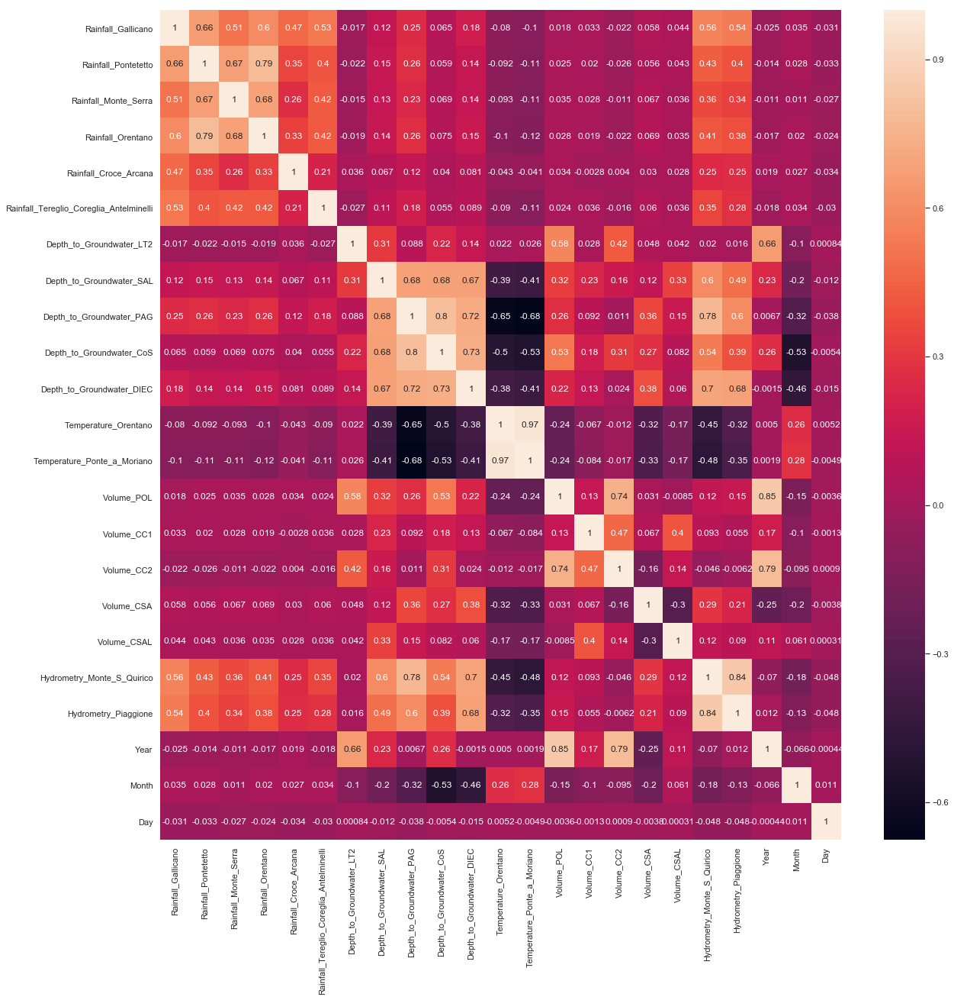

In [ ]:
sns.set(rc={'figure.figsize':(20,20)})
sns.heatmap(df.corr(),annot=True)